## Acoustics Toolbox
@Copyright Xingzihan 

导入

In [2]:
import arlpy.uwapm as pm
import arlpy.plot as plt
import numpy as np

pm.models()

['bellhop']

#### 1.创建环境
使用`pm.create_env2d()`创建海底环境

In [3]:
# bathy = [
#         [0, 30],    # 30 m water depth at the transmitter
#         [300, 20],  # 20 m water depth 300 m away
#         [1000, 25]  # 25 m water depth at 1 km
# ]
ssp = [
  [  0.0 , 1548.52],[200.0 , 1530.29],[400.0 , 1517.78],[600.0 , 1509.49 ],  [800.0 , 1504.30],[1000.0 , 1501.38],
  [1200.0 ,1500.14],[1400.0 ,  1500.12], [1600.0 ,1501.02],[1800.0 , 1502.57] ,[2000.0 , 1504.62],[2200.0 , 1507.02 ],  
  [2400.0 , 1509.69 ],[2600.0 , 1512.55],[2800.0 , 1515.56],[3000.0 , 1518.67 ],[3200.0 , 1521.85 ],[3400.0 , 1525.10 ],
  [3600.0 , 1528.38],[3800.0 , 1531.70],[4000.0 , 1535.04],[4200.0 , 1538.39],[4400.0 , 1541.76 ],[4600.0 , 1545.14],
  [4800.0 , 1548.52 ],[5000.0 , 1551.91]
]

env = pm.create_env2d(
#     depth=bathy,
    soundspeed=ssp,
    depth=5000,     #默认设置是30，应该随ssp更改
    bottom_soundspeed=1551.91,
    bottom_density=1200,
    bottom_absorption=1.0,
    nbeams=70,
    tx_depth=15,
    frequency=4000,
    rx_range=200000
    )
pm.print_env(env)

                name : arlpy
   bottom_absorption : 1.0
      bottom_density : 1200
    bottom_roughness : 0
   bottom_soundspeed : 1551.91
               depth : 5000
        depth_interp : linear
           frequency : 4000
           max_angle : 80
           min_angle : -80
              nbeams : 70
            rx_depth : 10
            rx_range : 200000
          soundspeed : [[   0.   1548.52]
                        [ 200.   1530.29]
                        [ 400.   1517.78]
                        [ 600.   1509.49]
                        [ 800.   1504.3 ]
                        [1000.   1501.38]
                        [1200.   1500.14]
                        [1400.   1500.12]
                        [1600.   1501.02]
                        [1800.   1502.57]
                        [2000.   1504.62]
                        [2200.   1507.02]
                        [2400.   1509.69]
                        [2600.   1512.55]
                        [2800.   1515.56]
         

绘制海底环境

In [4]:
print("海底环境")
pm.plot_env(env, width=900)
print("声速梯度")
pm.plot_ssp(env)

海底环境


声速梯度


#### 2.绘制声线
`pm.compute_rays(env)`计算声线

In [5]:
rays = pm.compute_rays(env)
pm.plot_rays(rays, env=env, width=900)

`pm.compute_eigenrays(env)`计算本征声线

In [6]:
env['rx_range'] = 60000

eigenrays = pm.compute_eigenrays(env)
pm.plot_rays(eigenrays, env=env, width=900)

#### 3.计算单位脉冲响应
`pm.compute_arrivals(env)`计算到达的信号

In [7]:
arrivals = pm.compute_arrivals(env)
pm.plot_arrivals(arrivals, width=900)

`arrivals`是pandas类型，可以取前10个进行计算

In [8]:
arrivals[arrivals.arrival_number < 10][['time_of_arrival', 'angle_of_arrival', 'surface_bounces', 'bottom_bounces']]

,time_of_arrival,angle_of_arrival,surface_bounces,bottom_bounces
1,41.571754,21.741678,3,2
2,41.598820,-18.212435,2,2
3,39.896683,15.276304,2,1
4,39.895706,15.229768,1,1
5,41.593792,-18.212418,1,2
6,41.566021,21.741604,2,2


`arrivals_ro_impulse_response()`计算单位脉冲响应

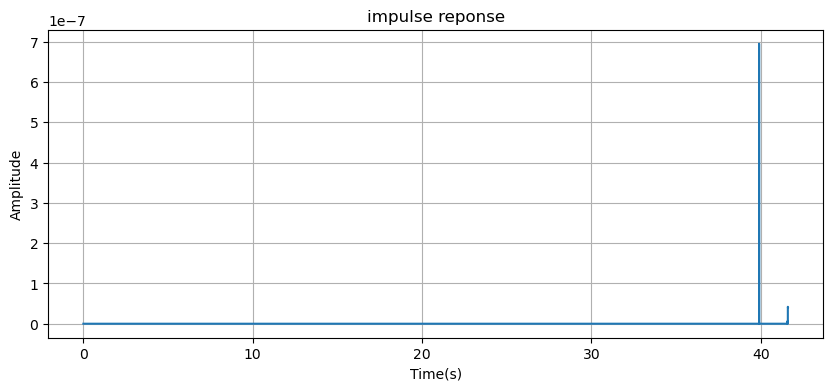

In [27]:
ir = pm.arrivals_to_impulse_response(arrivals, fs=24000,abs_time=True)
#plt.plot(np.abs(ir), fs=24000, width=900,ylim=(0,10e-14))
tmax = 41.598820
import matplotlib.pyplot as pyplt
t = np.linspace(0,tmax,len(ir))

pyplt.figure(figsize=(10,4))
pyplt.plot(t,np.abs(ir))
pyplt.xlabel("Time(s)");pyplt.ylabel("Amplitude");pyplt.title("impulse reponse");
pyplt.grid(True)
pyplt.show()




#### 4.计算传播损失

In [13]:

'''计算传播损失需要修改环境中的点数'''
env['rx_range'] = np.linspace(0, 200000, 4001)
env['rx_depth'] = np.linspace(0, 5000, 501)

tloss = pm.compute_transmission_loss(env)
pm.plot_transmission_loss(tloss, env=env,clim=[-200,0],width=900)